## Linear Regression

In [3]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns

In [5]:
%matplotlib inline

In [6]:
df = pd.read_csv('./USA_Housing.csv')
df.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


In [7]:
df.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [8]:
df.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


In [9]:
df.columns

Index([&#39;Avg. Area Income&#39;, &#39;Avg. Area House Age&#39;, &#39;Avg. Area Number of Rooms&#39;,
       &#39;Avg. Area Number of Bedrooms&#39;, &#39;Area Population&#39;, &#39;Price&#39;, &#39;Address&#39;],
      dtype=&#39;object&#39;)

&lt;seaborn.axisgrid.PairGrid at 0x2b61e1c3a00&gt;

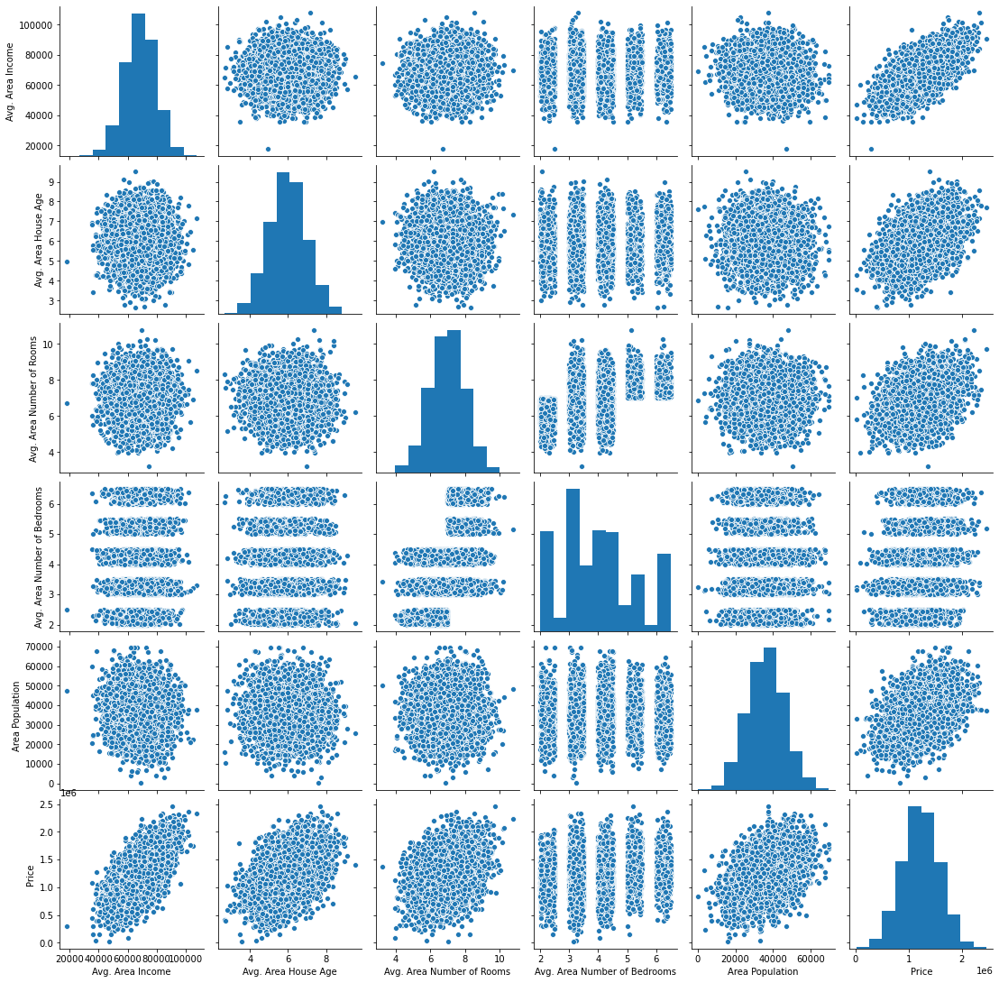

In [10]:
sns.pairplot(data=df)

&lt;AxesSubplot:xlabel=&#39;Price&#39;&gt;

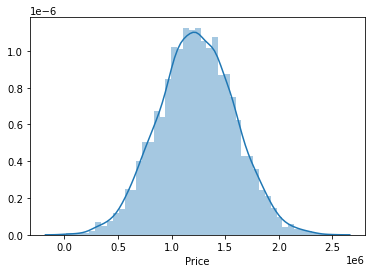

In [11]:
sns.distplot(df['Price'])

&lt;AxesSubplot:&gt;

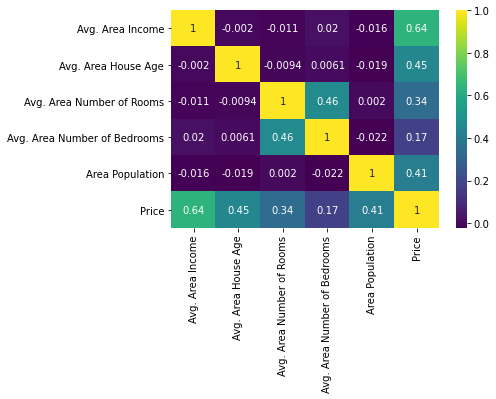

In [12]:
sns.heatmap(df.corr(), cmap='viridis', annot=True)

### Lets start to predict the price using scikit-learn

In [13]:
df.columns

Index([&#39;Avg. Area Income&#39;, &#39;Avg. Area House Age&#39;, &#39;Avg. Area Number of Rooms&#39;,
       &#39;Avg. Area Number of Bedrooms&#39;, &#39;Area Population&#39;, &#39;Price&#39;, &#39;Address&#39;],
      dtype=&#39;object&#39;)

In [14]:
X = df[['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population']]
X.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472


In [15]:
y = df['Price']
y.head()

0    1.059034e+06
1    1.505891e+06
2    1.058988e+06
3    1.260617e+06
4    6.309435e+05
Name: Price, dtype: float64

In [16]:
X.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 5 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
dtypes: float64(5)
memory usage: 195.4 KB


In [17]:
y

0       1.059034e+06
1       1.505891e+06
2       1.058988e+06
3       1.260617e+06
4       6.309435e+05
            ...     
4995    1.060194e+06
4996    1.482618e+06
4997    1.030730e+06
4998    1.198657e+06
4999    1.298950e+06
Name: Price, Length: 5000, dtype: float64

In [18]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression 

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)

In [21]:
X_train.info()

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
Int64Index: 3500 entries, 3871 to 4668
Data columns (total 5 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              3500 non-null   float64
 1   Avg. Area House Age           3500 non-null   float64
 2   Avg. Area Number of Rooms     3500 non-null   float64
 3   Avg. Area Number of Bedrooms  3500 non-null   float64
 4   Area Population               3500 non-null   float64
dtypes: float64(5)
memory usage: 164.1 KB


In [22]:
reg = LinearRegression()

In [23]:
reg.fit(X_train, y_train)

LinearRegression()

In [24]:
y_pred = reg.predict(X_test)

In [25]:
# Intercept
reg.intercept_

-2635115.2048447123

In [26]:
# Co-efficient
reg.coef_

array([2.14947367e+01, 1.66350615e+05, 1.21244218e+05, 3.42769296e+02,
       1.52028081e+01])

In [27]:
from sklearn.metrics import mean_squared_error, r2_score

In [28]:
mean_squared_error(y_test, y_pred)

10441708875.136688

In [29]:
r2_score(y_test, y_pred)

0.9189827943929467

In [31]:
X_test

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
319,76547.956698,6.503221,6.974804,3.08,40564.644888
91,72145.967213,6.398626,8.258635,6.06,28882.900855
2197,68057.065802,6.748409,7.883019,6.20,52547.829166
2164,70791.519074,5.086479,5.293383,4.03,19314.632852
2920,75851.043663,6.298704,7.151477,4.45,26831.543400
...,...,...,...,...,...
833,63856.308499,7.456390,6.844399,3.41,31114.897400
3437,57535.887652,4.090968,7.572639,5.01,31668.246117
3098,68222.742583,6.309069,7.057062,6.22,32660.439711
561,69503.150445,5.258393,6.873656,4.12,45266.529441


In [32]:
y_test

319     1.554635e+06
91      1.439506e+06
2197    1.754576e+06
2164    7.387607e+05
2920    1.283997e+06
            ...     
833     1.311903e+06
3437    8.263061e+05
3098    1.064703e+06
561     1.180989e+06
946     1.285158e+06
Name: Price, Length: 1500, dtype: float64

In [36]:
cdf = pd.DataFrame(data=reg.coef_, index=X.columns, columns=['Coeff'])
cdf.head()

,Coeff
Avg. Area Income,21.494737
Avg. Area House Age,166350.614571
Avg. Area Number of Rooms,121244.217765
Avg. Area Number of Bedrooms,342.769296
Area Population,15.202808


&lt;matplotlib.collections.PathCollection at 0x2b62a58d0d0&gt;

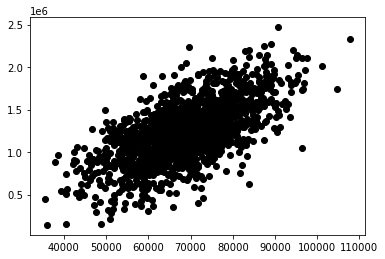

In [39]:
plt.scatter(X_test['Avg. Area Income'], y_test, color='black')

&lt;matplotlib.collections.PathCollection at 0x2b62ad57d90&gt;

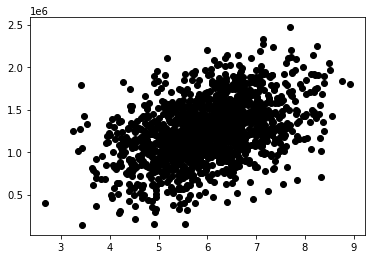

In [47]:
plt.scatter(X_test['Avg. Area House Age'], y_test, color='black')

&lt;matplotlib.collections.PathCollection at 0x2b62c802eb0&gt;

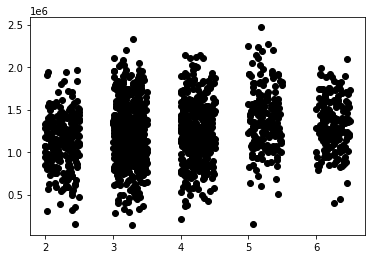

In [48]:
plt.scatter(X_test['Avg. Area Number of Bedrooms'], y_test, color='black')

&lt;matplotlib.collections.PathCollection at 0x2b62c833a30&gt;

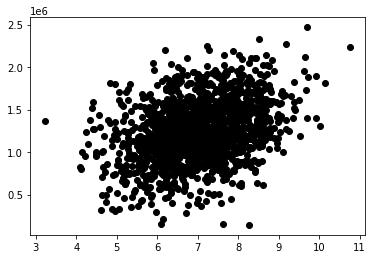

In [49]:
plt.scatter(X_test['Avg. Area Number of Rooms'], y_test, color='black')